<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Visualize-Correlation-Tensor" data-toc-modified-id="Visualize-Correlation-Tensor-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Visualize Correlation Tensor</a></span></li><li><span><a href="#Visualizing-the-Weighted-Feature-Tensor" data-toc-modified-id="Visualizing-the-Weighted-Feature-Tensor-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Visualizing the Weighted Feature Tensor</a></span></li><li><span><a href="#Visualizing-Neurons" data-toc-modified-id="Visualizing-Neurons-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Visualizing Neurons</a></span></li><li><span><a href="#FC7-GAN" data-toc-modified-id="FC7-GAN-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>FC7 GAN</a></span></li><li><span><a href="#FC6-GAN" data-toc-modified-id="FC6-GAN-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>FC6 GAN</a></span></li></ul></div>

## Visualize Correlation Tensor

In [1]:
mat_path = r"E:\OneDrive - Washington University in St. Louis\Mat_Statistics"
from scipy.io import loadmat
from skimage.io import imread, imread_collection
from os.path import join
import numpy as np
import matplotlib.pylab as plt

In [8]:
#%% Load the fit the data
Animal = "Beto"
Expi = 11
layer = "conv4_3"
ccdata = loadmat(r"E:\OneDrive - Washington University in St. Louis\CNNFeatCorr\%s_Manif_Exp%d_%s.mat"%(Animal, Expi, layer))
cc_tsr = ccdata['cc_tsr']
wdw_vect = ccdata['wdw_vect']

In [3]:
from time import time, sleep

In [4]:
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np
from IPython.display import display, clear_output

In [35]:
from matplotlib import use as usebackend
from celluloid import Camera
# usebackend('nbAgg')

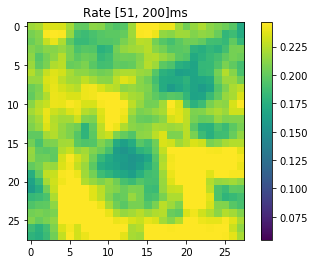

In [9]:
L1_data = np.mean(np.abs(cc_tsr), axis=2)
VMIN, VMAX = np.percentile(L1_data,[2,98])
fig, ax = plt.subplots()
ccmap = ax.imshow(L1_data[:, :, 10],vmin=VMIN,vmax=VMAX)
Title = ax.set_title("Rate [1, 20]ms")
plt.colorbar(ccmap)
for fi in range(cc_tsr.shape[-1]):
#     l.set_data(t[:fi], x[:fi])# animate(i)
    wdw = wdw_vect[fi,:]
    ccmap.set_data(L1_data[:, :, fi])
    Title.set_text("Rate [%d, %d]ms"%(wdw[0], wdw[1]))
    plt.pause(0.2)
    clear_output(wait=True)
    display(fig)

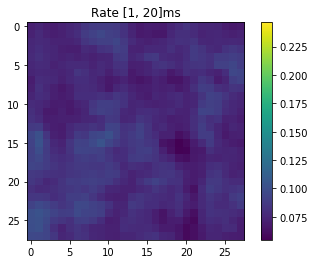

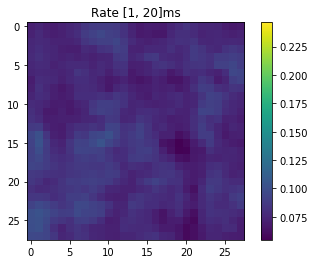

In [41]:
L1_data = np.mean(np.abs(cc_tsr), axis=2)
VMIN, VMAX = np.percentile(L1_data,[2,98])
fig, ax = plt.subplots()
ccmap = ax.imshow(L1_data[:, :, 10],vmin=VMIN,vmax=VMAX)
Title = ax.set_title("Rate [1, 20]ms")
plt.colorbar(ccmap)
def update(fi):
    wdw = wdw_vect[fi,:]
    ccmap.set_data(L1_data[:, :, fi])
    Title.set_text("Rate [%d, %d]ms"%(wdw[0], wdw[1]))
    clear_output(wait=True)
    display(fig)

anims = animation.FuncAnimation(fig, update, frames=cc_tsr.shape[-1], interval=200, blit=False,
                              repeat_delay=2000)
anims.save('Beto_Manif_Exp11_conv4-3_nothresh.mp4')
plt.show()

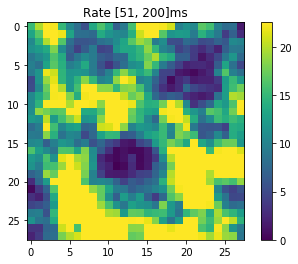

In [24]:
ThrL1_data = np.abs(cc_tsr)
ThrL1_data[ThrL1_data < 0.5] = 0
ThrL1_data = ThrL1_data.sum(2)
VMIN, VMAX = np.percentile(ThrL1_data,[2,98])
fig, ax = plt.subplots()
ccmap = ax.imshow(ThrL1_data[:, :, 10],vmin=VMIN,vmax=VMAX)
Title = ax.set_title("Rate [1, 20]ms")
plt.colorbar(ccmap)
for fi in range(cc_tsr.shape[-1]):
#     l.set_data(t[:fi], x[:fi])# animate(i)
    wdw = wdw_vect[fi,:]
    ccmap.set_data(ThrL1_data[:, :, fi])
    Title.set_text("Rate [%d, %d]ms"%(wdw[0], wdw[1]))
    plt.pause(0.2)
    clear_output(wait=True)
    display(fig)



In [26]:
import matplotlib.animation as animation

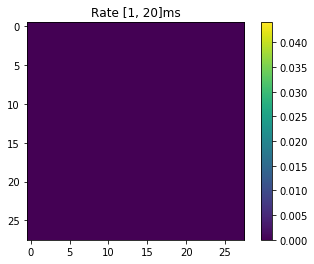

In [40]:
ThrL1_data = np.abs(cc_tsr)
ThrL1_data[ThrL1_data < 0.5] = 0
ThrL1_data = ThrL1_data.mean(2)
VMIN, VMAX = np.percentile(ThrL1_data,[2,98])
fig, ax = plt.subplots()
ccmap = ax.imshow(ThrL1_data[:, :, 10],vmin=VMIN,vmax=VMAX)
Title = ax.set_title("Rate [1, 20]ms")
plt.colorbar(ccmap)

def update(fi):
    wdw = wdw_vect[fi,:]
    ccmap.set_data(ThrL1_data[:, :, fi])
    Title.set_text("Rate [%d, %d]ms"%(wdw[0], wdw[1]))
    plt.pause(0.2)
    clear_output(wait=True)
    display(fig)
anims = animation.FuncAnimation(fig, update, frames=cc_tsr.shape[-1], interval=200, blit=False,
                              repeat_delay=2000)
anims.save('Beto_Manif_Exp11_conv4-3_2.mp4')
plt.show()

In [48]:
ThrM_data = np.abs(cc_tsr)
ThrM_data[ThrM_data < 0.5] = 0

(28, 28, 24)

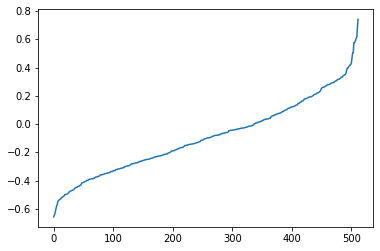

In [10]:
fi = 11
cc_vect = cc_tsr[10, 10, :, fi]
plt.plot(sorted(cc_vect))
clear_output()
plt.show()

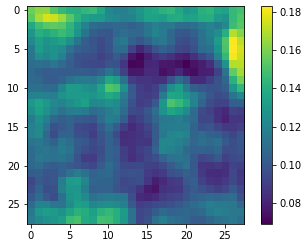

In [44]:
usebackend('nbAgg')
fig, ax = plt.subplots()
ccmap = ax.imshow(L1_data[:, :, 10])#,vmin=VMIN,vmax=VMAX)
plt.colorbar(ccmap)
clear_output()
plt.show()

In [66]:
#%%
layername_dict ={"vgg16":['conv1', 'conv1_relu',
                         'conv2', 'conv2_relu', 'pool1',
                         'conv3', 'conv3_relu',
                         'conv4', 'conv4_relu', 'pool2',
                         'conv5', 'conv5_relu',
                         'conv6', 'conv6_relu',
                         'conv7', 'conv7_relu', 'pool3',
                         'conv8', 'conv8_relu',
                         'conv9', 'conv9_relu',
                         'conv10', 'conv10_relu', 'pool4',
                         'conv11', 'conv11_relu',
                         'conv12', 'conv12_relu',
                         'conv13', 'conv13_relu', 'pool5',
                         'fc1', 'fc1_relu', 'dropout1',
                         'fc2', 'fc2_relu', 'dropout2',
                         'fc3'],
                 "densenet121":['conv1',
                                 'bn1',
                                 'bn1_relu',
                                 'pool1',
                                 'denseblock1', 'transition1',
                                 'denseblock2', 'transition2',
                                 'denseblock3', 'transition3',
                                 'denseblock4',
                                 'bn2',
                                 'fc1']}
from torchvision import models
from torchvision import transforms
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import  SGD, Adam
from lucent.optvis import render, param, transform, objectives
from lucent.optvis.transform import pad, jitter, random_rotate, random_scale
from matver_CNN import getMatVGG, lucent_layernames
from GAN_utils import upconvGAN, multiZupconvGAN

In [62]:
from lucent.optvis.objectives import wrap_objective
from lucent.optvis.objectives_util import _extract_act_pos
@wrap_objective()
def neuron_weight(layer, weight=None, x=None, y=None, batch=None):
    """ Linearly weighted channel activation at one location as objective
    weight: a torch Tensor vector same length as channel.
    """
    def inner(model):
        layer_t = model(layer)
        layer_t = _extract_act_pos(layer_t, x, y)
        if weight is None:
            return -layer_t.mean()
        else:
            return -(layer_t.squeeze() * weight).mean()
    return inner
@wrap_objective()
def channel_weight(layer, weight, batch=None):
    """ Linearly weighted channel activation as objective
    weight: a torch Tensor vector same length as channel. """
    def inner(model):
        layer_t = model(layer)
        return -(layer_t * weight.view(1, -1, 1, 1)).mean()
    return inner
@wrap_objective()
def localgroup_weight(layer, weight=None, x=None, y=None, wx=1, wy=1, batch=None):
    """ Linearly weighted channel activation around some spot as objective
    weight: a torch Tensor vector same length as channel. """
    def inner(model):
        layer_t = model(layer)
        if weight is None:
            return -(layer_t[:, :, y:y + wy, x:x + wx]).mean()
        else:
            return -(layer_t[:, :, y:y+wy, x:x+wx] * weight.view(1,-1,1,1)).mean()
    return inner

@wrap_objective()
def featmap_weight(layer, weight, batch=None):
    """ Linearly weighted channel activation around some spot as objective
    weight: a torch Tensor vector same length as channel. """
    def inner(model):
        layer_t = model(layer)
        return -(layer_t * weight.view( (1,) + layer_t.shape[1:])).mean()
    return inner

In [55]:
matvgg = getMatVGG()
layernames = lucent_layernames(matvgg)
matvgg.cuda()

features.0.weight conv1_1_weight torch.Size([64, 3, 3, 3]) (3, 3, 3, 64)
features.0.bias conv1_1_bias torch.Size([64]) (64,)
features.2.weight conv1_2_weight torch.Size([64, 64, 3, 3]) (3, 3, 64, 64)
features.2.bias conv1_2_bias torch.Size([64]) (64,)
features.5.weight conv2_1_weight torch.Size([128, 64, 3, 3]) (3, 3, 64, 128)
features.5.bias conv2_1_bias torch.Size([128]) (128,)
features.7.weight conv2_2_weight torch.Size([128, 128, 3, 3]) (3, 3, 128, 128)
features.7.bias conv2_2_bias torch.Size([128]) (128,)
features.10.weight conv3_1_weight torch.Size([256, 128, 3, 3]) (3, 3, 128, 256)
features.10.bias conv3_1_bias torch.Size([256]) (256,)
features.12.weight conv3_2_weight torch.Size([256, 256, 3, 3]) (3, 3, 256, 256)
features.12.bias conv3_2_bias torch.Size([256]) (256,)
features.14.weight conv3_3_weight torch.Size([256, 256, 3, 3]) (3, 3, 256, 256)
features.14.bias conv3_3_bias torch.Size([256]) (256,)
features.17.weight conv4_1_weight torch.Size([512, 256, 3, 3]) (3, 3, 256, 512)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [63]:
matVGG_lucentlayer_trans= {"conv1_1" : "features_0", 
        "conv1_1" : "features_0", 
        "conv1_2" : "features_2", 
        "conv1_2" : "features_2", 
        "conv2_1" : "features_5", 
        "conv2_1" : "features_5", 
        "conv2_2" : "features_7", 
        "conv2_2" : "features_7", 
        "conv3_1" : "features_10", 
        "conv3_1" : "features_10", 
        "conv3_2" : "features_12", 
        "conv3_2" : "features_12", 
        "conv3_3" : "features_14", 
        "conv3_3" : "features_14", 
        "conv4_1" : "features_17", 
        "conv4_1" : "features_17", 
        "conv4_2" : "features_19", 
        "conv4_2" : "features_19", 
        "conv4_3" : "features_21", 
        "conv4_3" : "features_21", 
        "conv5_1" : "features_24", 
        "conv5_1" : "features_24", 
        "conv5_2" : "features_26", 
        "conv5_2" : "features_26", 
        "conv5_3" : "features_28", 
        "conv5_3" : "features_28", 
        "fc6" : "classifier_0", 
        "fc6" : "classifier_0", 
        "fc7" : "classifier_3", 
        "fc7" : "classifier_3", 
        "fc8" : "classifier_6", 
        "fc8" : "classifier_6", }

cc_layer = "conv4_3"
lucent_tgt = matVGG_lucentlayer_trans[cc_layer]

In [64]:
#%% Set the mean and preprocessing for matlab VGG. 
RGBmean = torch.tensor([123.6800, 116.7790, 103.9390]).cuda().reshape([1, 3, 1, 1])
def matVGG_preprocess(x):
    return 255 * x - RGBmean

Using `fc7` GAN to activate this single neuron is not very helpful.

In [94]:
G = upconvGAN("fc7")
G.requires_grad_(False).cuda()
def GANparam(batch=1, sd=1):
    code = (torch.randn((batch, G.codelen)) * sd).to("cuda").requires_grad_(True)
    imagef = lambda:  G.visualize(code)
    return [code], imagef

  2%|█▎                                                                                | 2/128 [00:00<00:08, 14.29it/s]

Initial loss: -0.000


 52%|█████████████████████████████████████████▊                                       | 66/128 [00:04<00:04, 15.08it/s]

Loss at step 64: -0.000


100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:08<00:00, 15.15it/s]

Loss at step 128: -0.000



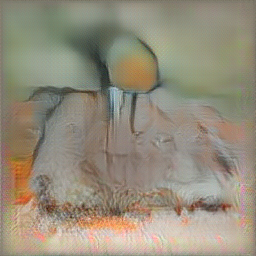
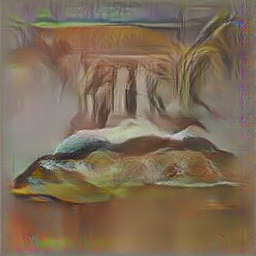

In [109]:
fi = 10
cc_vect = cc_tsr[10, 10, :, fi]
iCh = cc_vect.argmax()
GANparam_f = lambda: GANparam(batch=2, sd=1.5)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = objectives.neuron(lucent_tgt, n_channel=iCh, x=10, y=10, batch=None)# - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=False, preprocess=False,show_image=False,
                           thresholds=(64, 128, ), verbose=True)
render.show(images[-1])

## Visualizing the Weighted Feature Tensor

It seems `fc6` GAN is more successful in activating the most selecting unit.

In [67]:
G = upconvGAN("fc6")
G.requires_grad_(False).cuda()
def GANparam(batch=1, sd=1):
    code = (torch.randn((batch, G.codelen)) * sd).to("cuda").requires_grad_(True)
    imagef = lambda:  G.visualize(code)
    return [code], imagef

In [111]:
np.percentile(ThrL1_data[:,:,:,fi],99)

0.556622251868248

  1%|▍                                                                                 | 1/192 [00:00<00:24,  7.88it/s]

Initial loss: 0.162


 34%|███████████████████████████▍                                                     | 65/192 [00:07<00:15,  8.26it/s]

Loss at step 64: -4.903


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:15<00:07,  8.26it/s]

Loss at step 128: -7.876


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:22<00:00,  8.44it/s]


Loss at step 192: -7.055



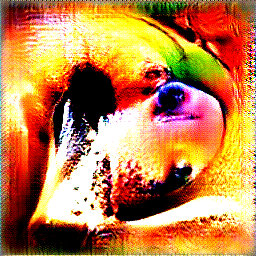
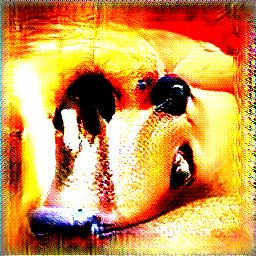
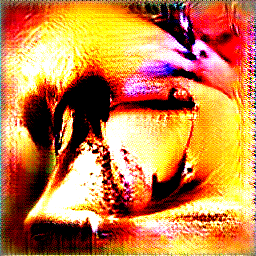
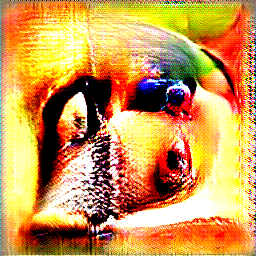

In [113]:
# Test no thresholding (Baseline)
Thrcc_tsr = torch.from_numpy(cc_tsr).permute([3,2,0,1])
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True)]
fi = 11;divL = 0.01
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = featmap_weight(lucent_tgt, Thrcc_tsr[fi,:].cuda(), batch=None) - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, preprocess=False, thresholds=(64, 128, 192), 
                           show_inline=False, show_image=False,verbose=True)
render.show(images[-1])

> What if the Generator Changes to `fc7` or `fc8`

  1%|▍                                                                                 | 1/192 [00:00<00:23,  8.07it/s]

Initial loss: -0.356


 34%|███████████████████████████▍                                                     | 65/192 [00:07<00:15,  8.15it/s]

Loss at step 64: -5.011


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:15<00:07,  8.05it/s]

Loss at step 128: -6.388


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:23<00:00,  8.28it/s]


Loss at step 192: -5.736



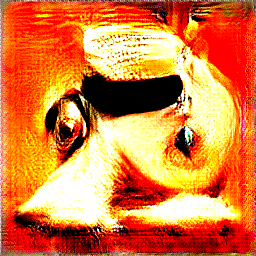
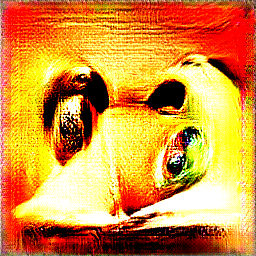
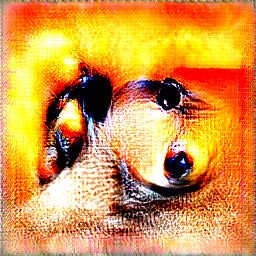
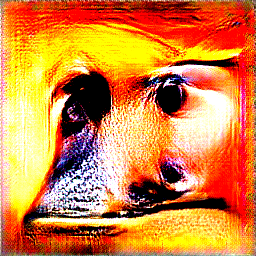

In [121]:
# Test no thresholding (Baseline) But use fc7 GAN
G = upconvGAN("fc7")
G.requires_grad_(False).cuda()
def GANparam(batch=1, sd=1):
    code = (torch.randn((batch, G.codelen)) * sd).to("cuda").requires_grad_(True)
    imagef = lambda:  G.visualize(code)
    return [code], imagef

Thrcc_tsr = torch.from_numpy(cc_tsr).permute([3,2,0,1])
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True)]
fi = 11;divL = 0.01
GANparam_f = lambda: GANparam(batch=4, sd=0.8)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = featmap_weight(lucent_tgt, Thrcc_tsr[fi,:].cuda(), batch=None) - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, preprocess=False, thresholds=(64, 128, 192), 
                           show_inline=False, show_image=False,verbose=True)
render.show(images[-1])

Initial loss: -0.140

  1%|▍                                                                                 | 1/192 [00:00<00:23,  8.00it/s]

 34%|███████████████████████████▍                                                     | 65/192 [00:07<00:15,  8.10it/s]

Loss at step 64: -3.451


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:15<00:08,  7.84it/s]

Loss at step 128: -3.770


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:23<00:00,  8.17it/s]


Loss at step 192: -4.367



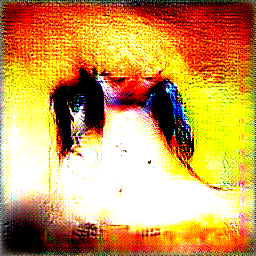
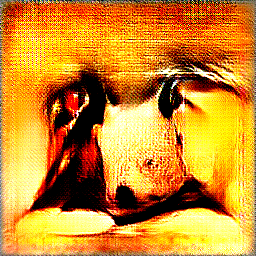
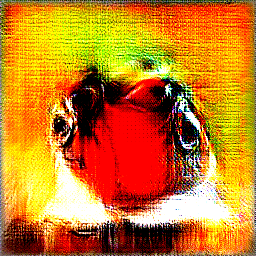
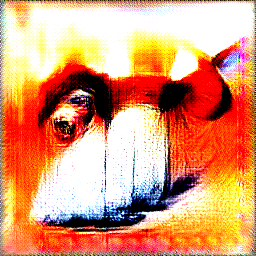

In [117]:
# Test no thresholding (Baseline) But use fc8 GAN
G = upconvGAN("fc8")
G.requires_grad_(False).cuda()
def GANparam(batch=1, sd=1):
    code = (torch.randn((batch, G.codelen)) * sd).to("cuda").requires_grad_(True)
    imagef = lambda:  G.visualize(code)
    return [code], imagef

Thrcc_tsr = torch.from_numpy(cc_tsr).permute([3,2,0,1])
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True)]
fi = 11;divL = 0.01
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = featmap_weight(lucent_tgt, Thrcc_tsr[fi,:].cuda(), batch=None) - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, preprocess=False, thresholds=(64, 128, 192), 
                           show_inline=False, show_image=False,verbose=True)
render.show(images[-1])

  1%|▍                                                                                 | 1/192 [00:00<00:23,  8.20it/s]

Initial loss: 0.014


 34%|███████████████████████████▍                                                     | 65/192 [00:07<00:15,  8.14it/s]

Loss at step 64: -0.879


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:15<00:07,  8.14it/s]

Loss at step 128: -1.083


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:22<00:00,  8.36it/s]


Loss at step 192: -1.069



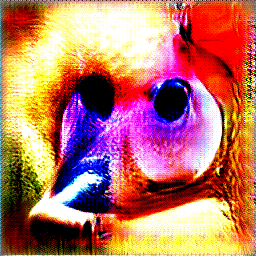
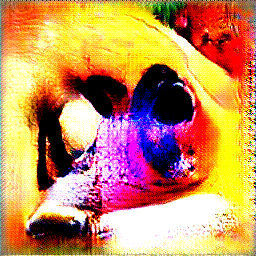
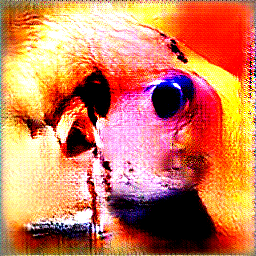
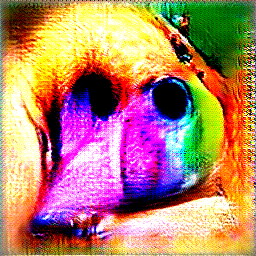

In [112]:
# 2 sided thresholding
thresh = 0.556
Thrcc_tsr = cc_tsr.copy()
ThrL1_data = np.abs(cc_tsr)
Thrcc_tsr[ThrL1_data < thresh] = 0
Thrcc_tsr = torch.from_numpy(Thrcc_tsr).permute([3,2,0,1])
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True)]
fi = 11;divL = 0.01
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = featmap_weight(lucent_tgt, Thrcc_tsr[fi,:].cuda(), batch=None) - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, preprocess=False, thresholds=(64, 128, 192), 
                           show_inline=False, show_image=False,verbose=True)
render.show(images[-1])

In [104]:
np.percentile(cc_tsr[:,:,:,fi],99.7)

0.5943466244339933

  1%|▍                                                                                 | 1/192 [00:00<00:22,  8.55it/s]

Initial loss: -0.021


 34%|███████████████████████████▍                                                     | 65/192 [00:07<00:14,  8.80it/s]

Loss at step 64: -0.383


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:14<00:07,  8.72it/s]

Loss at step 128: -0.441


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:21<00:00,  8.98it/s]


Loss at step 192: -0.822



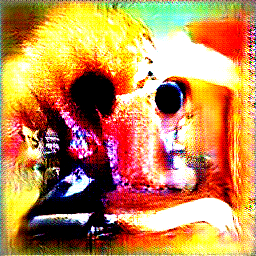
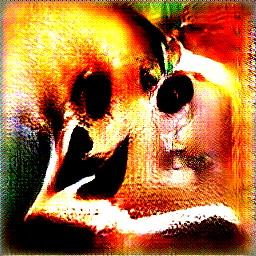
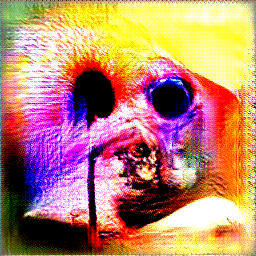
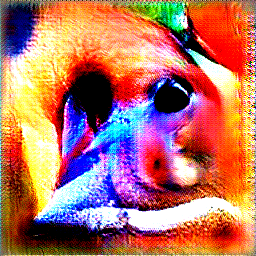

In [102]:
# Positive side thresholding
thresh = 0.6
Thrcc_tsr = cc_tsr.copy()
Thrcc_tsr[cc_tsr < thresh] = 0
Thrcc_tsr = torch.from_numpy(Thrcc_tsr).permute([3,2,0,1])
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True)]
fi = 11;#divL = 0.05
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = featmap_weight(lucent_tgt, Thrcc_tsr[fi,:].cuda(), batch=None) #- divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, preprocess=False, thresholds=(64, 128, 192), 
                           show_inline=False, show_image=False,verbose=True)
render.show(images[-1])

## Visualizing Neurons

> Adding "nuanced" transformations are useful to find gradient! Single neuron can easily get no gradient and stuck

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

fc6 GAN parametrization
Objective Neuron [features_21, 425, 10, 10, None]
Transforms[<function pad.<locals>.inner at 0x000001BA9E7F28B8>, <function jitter.<locals>.inner at 0x000001BAF4EA4828>, <function random_scale.<locals>.inner at 0x000001BAF4EA4948>, <function random_rotate.<locals>.inner at 0x000001BAF4EA4168>, <function jitter.<locals>.inner at 0x000001BAF4EA4CA8>, <function matVGG_preprocess at 0x000001BA8FDA6D38>]
Initial loss: -147.125


 26%|████████████████████▉                                                            | 33/128 [00:03<00:09, 10.05it/s]

Loss at step 32: -480.368


 51%|█████████████████████████████████████████▏                                       | 65/128 [00:06<00:06,  9.98it/s]

Loss at step 64: -967.978


100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:12<00:00, 10.04it/s]

Loss at step 128: -1642.434



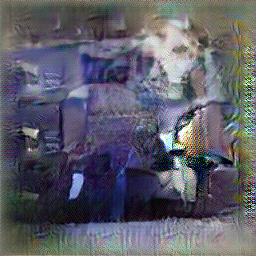
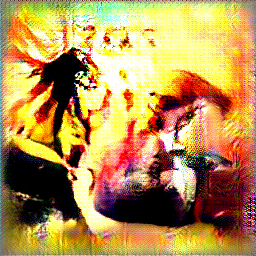

In [139]:
fi = 10
cc_vect = cc_tsr[10, 10, :, fi]
iCh = cc_vect.argmax()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,]
        #lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True),]
GANparam_f = lambda: GANparam(batch=2, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = objectives.neuron(lucent_tgt, n_channel=iCh, x=10, y=10, batch=None)# - divL * objectives.diversity('features_15')  #  optimizing the
# obj = neuron_weight(lucent_tgt, weight=iCh, x=10, y=10, batch=None)
print("%s GAN parametrization\nObjective %s\nTransforms%s"%(G.name, obj.description, str(tfms)))
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, thresholds=(32, 64, 128, ), 
                           show_inline=False, preprocess=False,show_image=False, verbose=True)
render.show(images[-1])

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

fc6 GAN parametrization
Objective Neuron_Weight [features_21, ..., 10, 10, None]
Transforms[<function pad.<locals>.inner at 0x000001BAF5AA0A68>, <function jitter.<locals>.inner at 0x000001BAF523F438>, <function random_scale.<locals>.inner at 0x000001BAF5567048>, <function random_rotate.<locals>.inner at 0x000001BAF5567318>, <function jitter.<locals>.inner at 0x000001BAF55671F8>, <function matVGG_preprocess at 0x000001BA8FDA6D38>, <function <lambda> at 0x000001BAF5567288>]
Initial loss: -0.030


 26%|████████████████████▉                                                            | 33/128 [00:03<00:10,  8.82it/s]

Loss at step 32: -1.241


 51%|█████████████████████████████████████████▏                                       | 65/128 [00:07<00:07,  8.82it/s]

Loss at step 64: -2.031


100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:14<00:00,  8.94it/s]


Loss at step 128: -1.872



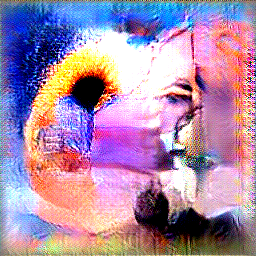
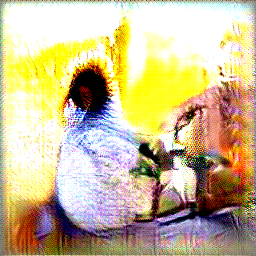
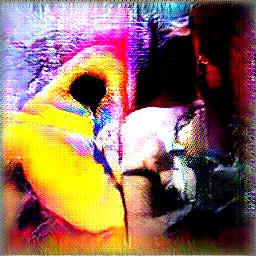
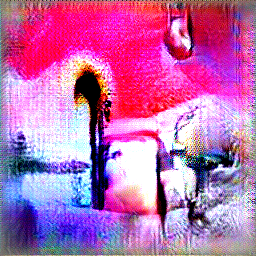

In [177]:
fi = 10;yi = 10;xi = 10
cc_vect = cc_tsr[yi, xi, :, fi]
thr = np.percentile(cc_vect, 95)
W_vect = torch.tensor(cc_vect, requires_grad=False).cuda()
W_vect[W_vect<thr] = 0
W_vect = W_vect / W_vect.sum()
iCh = cc_vect.argmax()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True),]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
# obj = objectives.neuron(lucent_tgt, n_channel=iCh, x=10, y=10, batch=None)# - divL * objectives.diversity('features_15')  #  optimizing the
obj = neuron_weight(lucent_tgt, weight=W_vect, x=xi, y=yi, batch=None)
print("%s GAN parametrization\nObjective %s\nTransforms%s"%(G.name, obj.description, str(tfms)))
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, thresholds=(32, 64, 128, ), 
                           show_inline=False, preprocess=False,show_image=False, verbose=True)
render.show(images[-1])

In [158]:
L1_data[12,18,:]

array([0.01231638, 0.01103996, 0.01410799, 0.01701707, 0.01498675,
       0.01402066, 0.01565779, 0.02014659, 0.0890832 , 0.13141799,
       0.1508777 , 0.15205975, 0.12457956, 0.08527246, 0.05687902,
       0.05272126, 0.05632462, 0.05838909, 0.06267392], dtype=float32)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

fc6 GAN parametrization
Objective Neuron_Weight [features_21, ..., 18, 12, None]
Transforms[<function pad.<locals>.inner at 0x000001BAF5536DC8>, <function jitter.<locals>.inner at 0x000001BAF523FE58>, <function random_scale.<locals>.inner at 0x000001BAF55673A8>, <function random_rotate.<locals>.inner at 0x000001BAF5567558>, <function jitter.<locals>.inner at 0x000001BAF5567798>, <function matVGG_preprocess at 0x000001BA8FDA6D38>, <function <lambda> at 0x000001BAF55674C8>]
Initial loss: -0.016


 26%|████████████████████▉                                                            | 33/128 [00:03<00:10,  8.85it/s]

Loss at step 32: -0.791


 51%|█████████████████████████████████████████▏                                       | 65/128 [00:07<00:07,  8.95it/s]

Loss at step 64: -1.829


100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:14<00:00,  9.03it/s]


Loss at step 128: -2.450



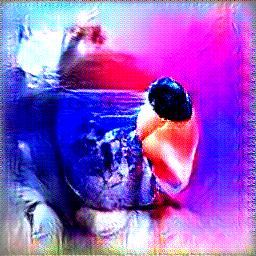
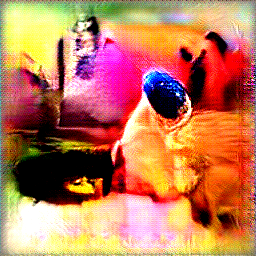
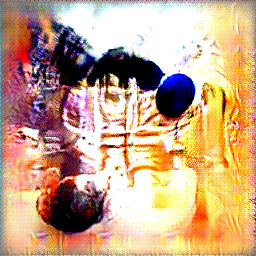
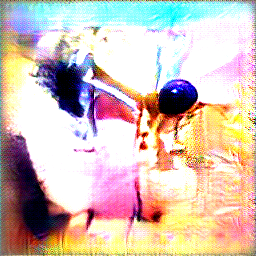

In [176]:
fi = 10;yi = 12;xi = 18
cc_vect = cc_tsr[yi, xi, :, fi]
thr = np.percentile(cc_vect, 95)
W_vect = torch.tensor(cc_vect, requires_grad=False).cuda()
W_vect[W_vect<thr] = 0
W_vect = W_vect / W_vect.sum()
iCh = cc_vect.argmax()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True),]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
# obj = objectives.neuron(lucent_tgt, n_channel=iCh, x=10, y=10, batch=None)# - divL * objectives.diversity('features_15')  #  optimizing the
obj = neuron_weight(lucent_tgt, weight=W_vect, x=xi, y=yi, batch=None)
print("%s GAN parametrization\nObjective %s\nTransforms%s"%(G.name, obj.description, str(tfms)))
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, thresholds=(32, 64, 128, ), 
                           show_inline=False, preprocess=False,show_image=False, verbose=True)
render.show(images[-1])

In [178]:
L1_data[27,10,]

array([0.01283821, 0.0130268 , 0.01293648, 0.01452323, 0.01179426,
       0.01030122, 0.00952693, 0.01656895, 0.08348561, 0.12451465,
       0.14742935, 0.14808066, 0.11538737, 0.08697584, 0.06574392,
       0.05283573, 0.05772546, 0.06501093, 0.06635533], dtype=float32)

  0%|                                                                                          | 0/192 [00:00<?, ?it/s]

fc6 GAN parametrization
Objective Neuron_Weight [features_21, ..., 10, 23, None]
Transforms[<function pad.<locals>.inner at 0x000001BAF4EA4AF8>, <function jitter.<locals>.inner at 0x000001BAF504CC18>, <function random_scale.<locals>.inner at 0x000001BAF504CE58>, <function random_rotate.<locals>.inner at 0x000001BAF51C3288>, <function jitter.<locals>.inner at 0x000001BAF51C3828>, <function matVGG_preprocess at 0x000001BA8FDA6D38>, <function <lambda> at 0x000001BAF51C3798>]
Initial loss: -0.023


 17%|█████████████▉                                                                   | 33/192 [00:03<00:17,  8.98it/s]

Loss at step 32: -0.708


 34%|███████████████████████████▍                                                     | 65/192 [00:07<00:14,  8.92it/s]

Loss at step 64: -1.186


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:14<00:07,  8.82it/s]

Loss at step 128: -1.235


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:21<00:00,  9.06it/s]

Loss at step 192: -2.008



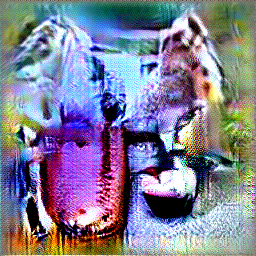
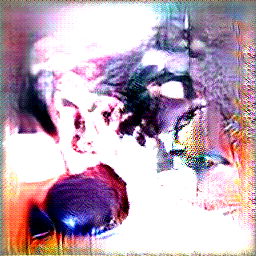
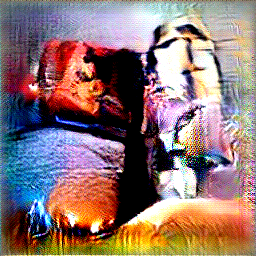
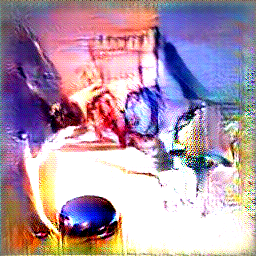

In [190]:
fi = 10;yi = 23;xi = 10
cc_vect = cc_tsr[yi, xi, :, fi]
thr = np.percentile(cc_vect, 95)
W_vect = torch.tensor(cc_vect, requires_grad=False).cuda()
W_vect[W_vect<thr] = 0
W_vect = W_vect / W_vect.sum()
iCh = cc_vect.argmax()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True),]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
# obj = objectives.neuron(lucent_tgt, n_channel=iCh, x=10, y=10, batch=None)# - divL * objectives.diversity('features_15')  #  optimizing the
obj = neuron_weight(lucent_tgt, weight=W_vect, batch=None, x=xi, y=yi, )#x=xi, y=yi, 
print("%s GAN parametrization\nObjective %s\nTransforms%s"%(G.name, obj.description, str(tfms)))
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, thresholds=(32, 64, 128, 192, ), 
                           show_inline=False, preprocess=False,show_image=False, verbose=True)
render.show(images[-2])


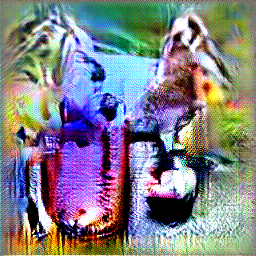
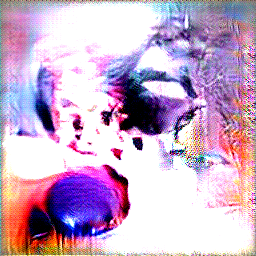
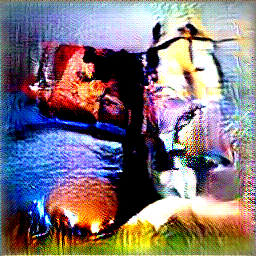
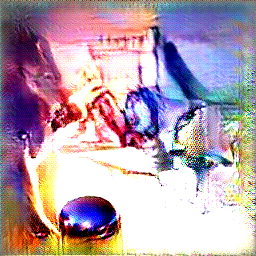

In [191]:
render.show(images[-1])

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

Pixel FFT Decorrelated parametrization
Objective Neuron_Weight [features_21, ..., 10, 26, None]
Transforms[<function pad.<locals>.inner at 0x000001BAF55670D8>, <function jitter.<locals>.inner at 0x000001BAF504CC18>, <function random_scale.<locals>.inner at 0x000001BAF504C948>, <function random_rotate.<locals>.inner at 0x000001BAF504C798>, <function jitter.<locals>.inner at 0x000001BAF504C168>, <function matVGG_preprocess at 0x000001BA8FDA6D38>, <function <lambda> at 0x000001BAF504C8B8>]
Initial loss: -0.000


 27%|█████████████████████▌                                                           | 34/128 [00:03<00:08, 10.84it/s]

Loss at step 32: -1.476


 52%|█████████████████████████████████████████▊                                       | 66/128 [00:06<00:05, 10.70it/s]

Loss at step 64: -1.890


100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:12<00:00, 10.54it/s]

Loss at step 128: -1.206



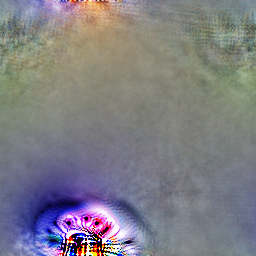
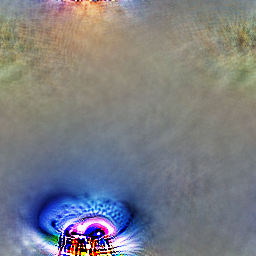
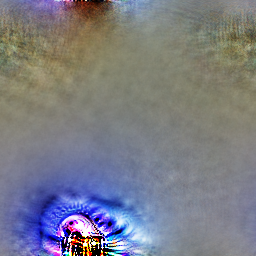
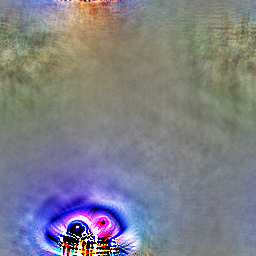

In [185]:
fi = 10;yi = 26;xi = 10
cc_vect = cc_tsr[yi, xi, :, fi]
thr = np.percentile(cc_vect, 95)
W_vect = torch.tensor(cc_vect, requires_grad=False).cuda()
W_vect[W_vect<thr] = 0
W_vect = W_vect / W_vect.sum()
iCh = cc_vect.argmax()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess,
        lambda x: F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=True),]
GANparam_f = lambda: param.image(256, fft=True, decorrelate=True, batch=4)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
# obj = objectives.neuron(lucent_tgt, n_channel=iCh, x=10, y=10, batch=None)# - divL * objectives.diversity('features_15')  #  optimizing the
obj = neuron_weight(lucent_tgt, weight=W_vect, x=xi, y=yi, batch=None)#
print("Pixel FFT Decorrelated parametrization\nObjective %s\nTransforms%s"%(obj.description, str(tfms)))
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, thresholds=(32, 64, 128, ), 
                           show_inline=False, preprocess=False,show_image=False, verbose=True)
render.show(images[-1])

## FC7 GAN

In [46]:
from GAN_utils import upconvGAN

In [82]:
savedir = r"E:\OneDrive - Washington University in St. Louis\InterpretCorrCoef\CNN_ref\fc7gan"
G = upconvGAN("fc7")
G.requires_grad_(False).cuda()
def GANparam(batch=1, sd=1):
    code = (torch.randn((batch, G.codelen)) * sd).to("cuda").requires_grad_(True)
    imagef = lambda:  G.visualize(code)
    return [code], imagef

  0%|                                                                                          | 0/256 [00:00<?, ?it/s]

Initial loss: 4.136


 25%|████████████████████▎                                                            | 64/256 [00:11<00:34,  5.58it/s]

Loss at step 64: -31.876


 50%|████████████████████████████████████████▎                                       | 129/256 [00:22<00:23,  5.46it/s]

Loss at step 128: -40.581


100%|████████████████████████████████████████████████████████████████████████████████| 256/256 [00:45<00:00,  5.57it/s]

Loss at step 256: -62.087



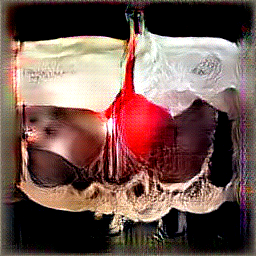
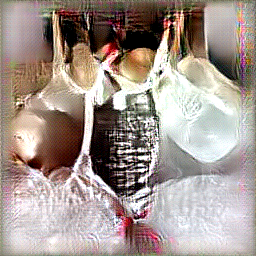
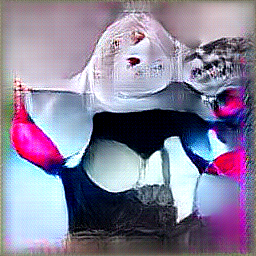
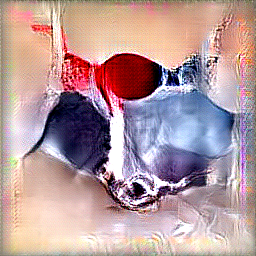

In [83]:
divL = .2e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=False, preprocess=False,show_image=False,
                           thresholds=(64, 128, 256, ), verbose=True)
render.show(images[-1])

  0%|▎                                                                                 | 1/256 [00:00<00:43,  5.82it/s]

Initial loss: -1.161


 25%|███████████████████▉                                                             | 63/256 [00:10<00:33,  5.70it/s]

Loss at step 64: -44.208



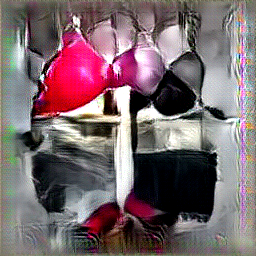
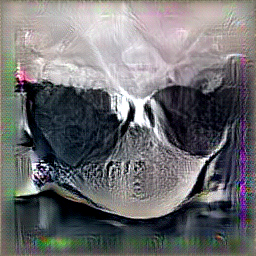
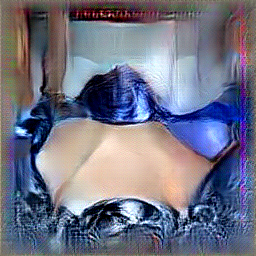
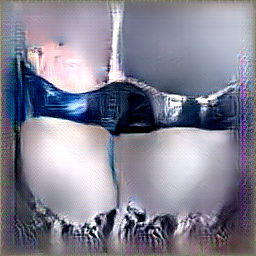

 50%|███████████████████████████████████████▋                                        | 127/256 [00:22<00:22,  5.66it/s]

Loss at step 128: -57.309



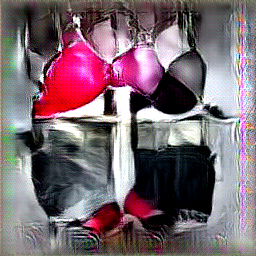
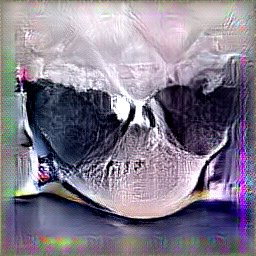
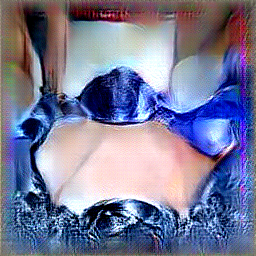
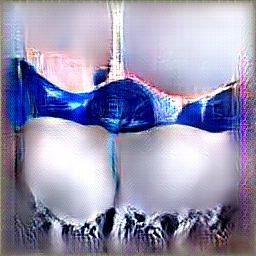

100%|███████████████████████████████████████████████████████████████████████████████▋| 255/256 [00:45<00:00,  5.46it/s]

Loss at step 256: -85.593



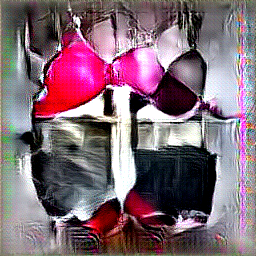
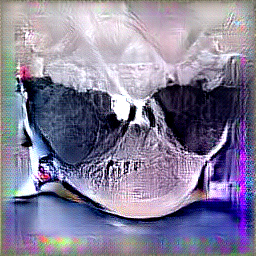
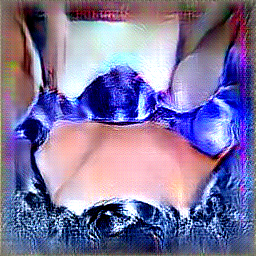
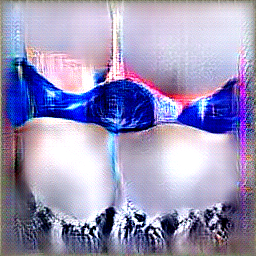

100%|████████████████████████████████████████████████████████████████████████████████| 256/256 [00:45<00:00,  5.61it/s]



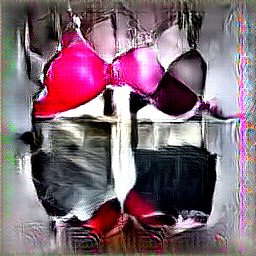
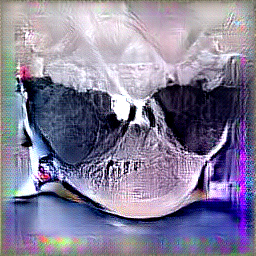
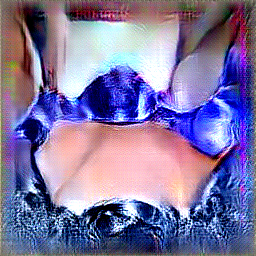
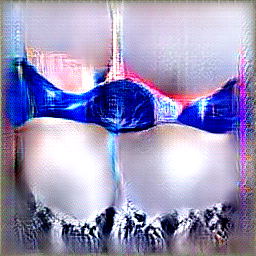

In [59]:
divL = .005e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=0.5)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) - divL * objectives.diversity('features_30')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=True, preprocess=False,show_image=False,
                           thresholds=(64, 128, 256, ), verbose=True)

  0%|▎                                                                                 | 1/256 [00:00<00:41,  6.14it/s]

Initial loss: -0.509


 25%|███████████████████▉                                                             | 63/256 [00:10<00:31,  6.05it/s]

Loss at step 64: -41.611



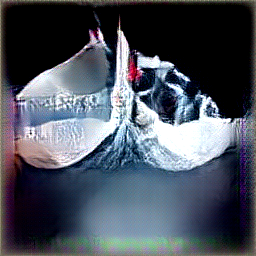
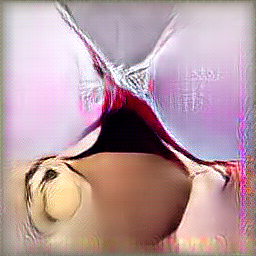
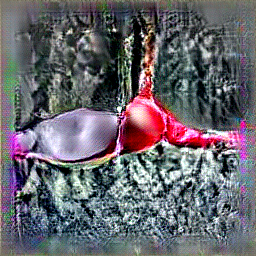
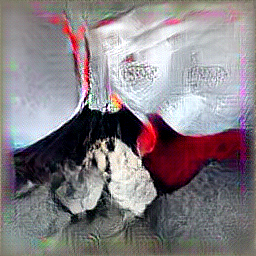

 50%|███████████████████████████████████████▋                                        | 127/256 [00:21<00:21,  5.98it/s]

Loss at step 128: -64.234



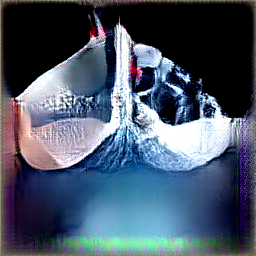
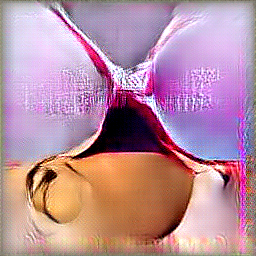
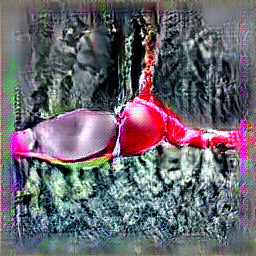
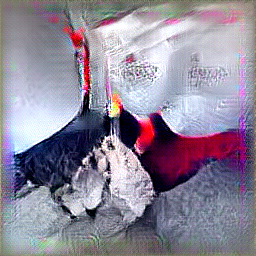

100%|███████████████████████████████████████████████████████████████████████████████▋| 255/256 [00:43<00:00,  6.01it/s]

Loss at step 256: -48.974



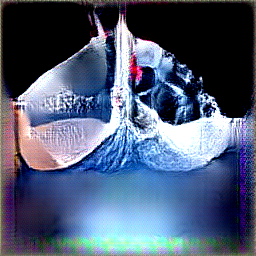
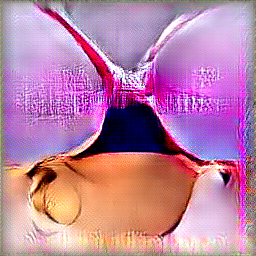
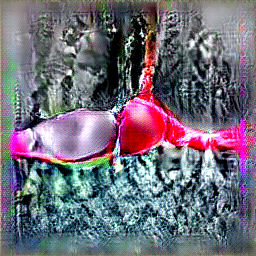
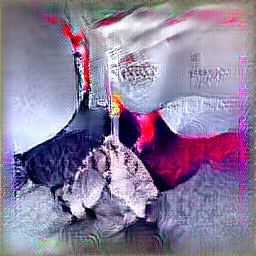

100%|████████████████████████████████████████████████████████████████████████████████| 256/256 [00:43<00:00,  5.91it/s]



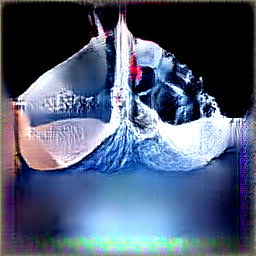
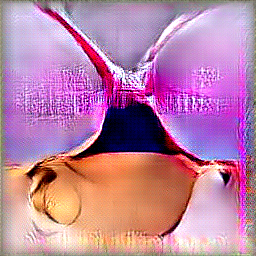
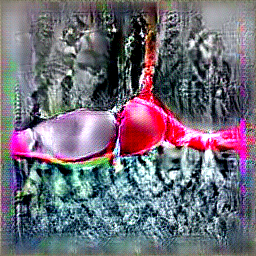
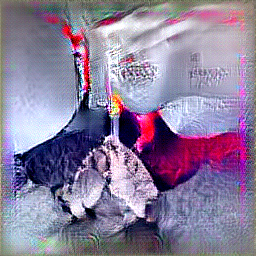

In [60]:
divL = .005e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=0.5)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) #- divL * objectives.diversity('features_30')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=True, preprocess=False,show_image=False,
                           thresholds=(64, 128, 256, ), verbose=True)

## FC6 GAN

In [61]:
savedir = r"E:\OneDrive - Washington University in St. Louis\InterpretCorrCoef\CNN_ref\fc7gan"
G = upconvGAN("fc6")
G.requires_grad_(False).cuda()
def GANparam(batch=1, sd=1):
    code = (torch.randn((batch, G.codelen)) * sd).to("cuda").requires_grad_(True)
    imagef = lambda:  G.visualize(code)
    return [code], imagef

  0%|▎                                                                                 | 1/256 [00:00<00:41,  6.21it/s]

Initial loss: 0.302


 25%|███████████████████▉                                                             | 63/256 [00:10<00:32,  5.97it/s]

Loss at step 64: -43.222



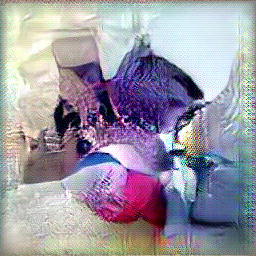
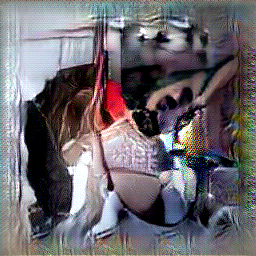
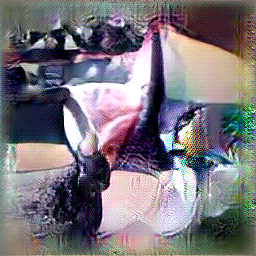
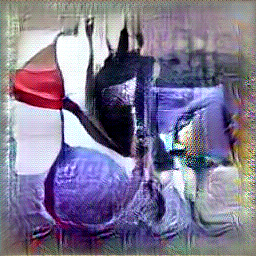

 50%|███████████████████████████████████████▋                                        | 127/256 [00:21<00:22,  5.81it/s]

Loss at step 128: -56.167



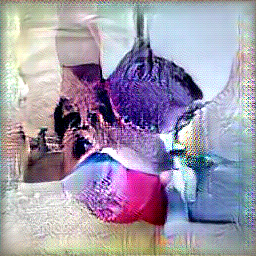
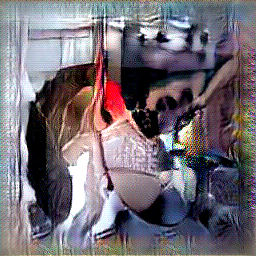
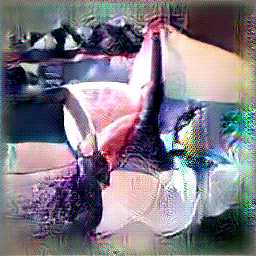
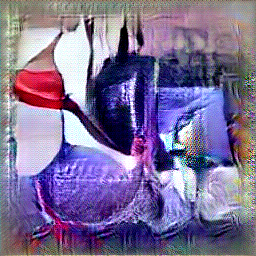

100%|███████████████████████████████████████████████████████████████████████████████▋| 255/256 [00:42<00:00,  5.89it/s]

Loss at step 256: -71.520



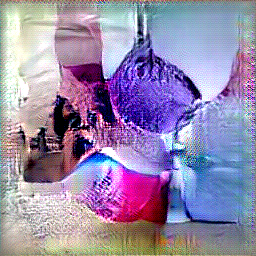
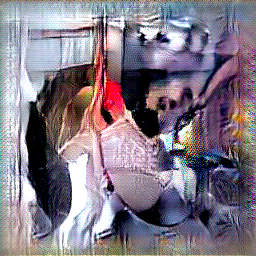
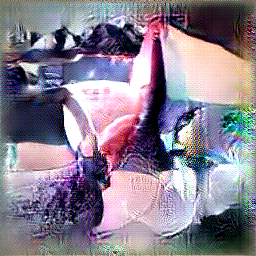
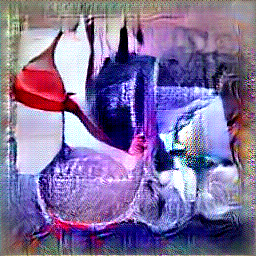

100%|████████████████████████████████████████████████████████████████████████████████| 256/256 [00:43<00:00,  5.95it/s]



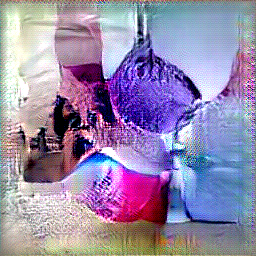
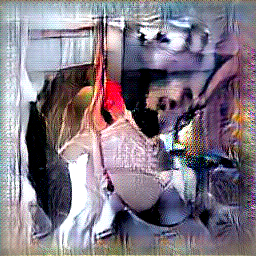
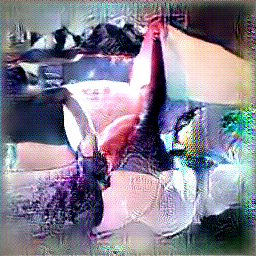
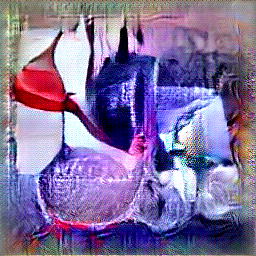

In [62]:
divL = .00e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) - divL * objectives.diversity('features_15')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=True, preprocess=False,
                           thresholds=(64, 128, 256, ), verbose=True)

  0%|▎                                                                                 | 1/256 [00:00<00:43,  5.85it/s]

Initial loss: 25.338


 25%|███████████████████▉                                                             | 63/256 [00:11<00:34,  5.61it/s]

Loss at step 64: -7.450



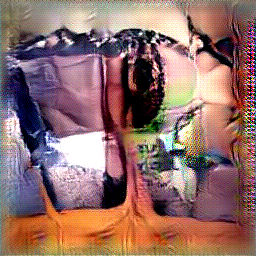
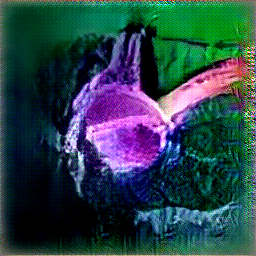
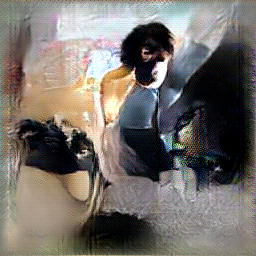
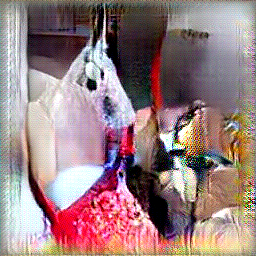

 50%|███████████████████████████████████████▋                                        | 127/256 [00:22<00:23,  5.55it/s]

Loss at step 128: -31.492



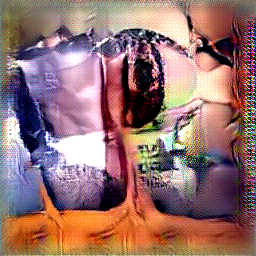
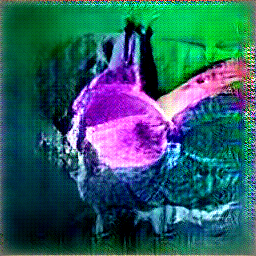
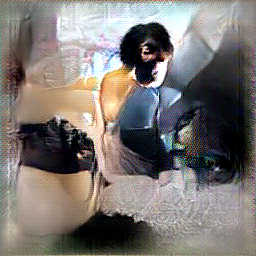
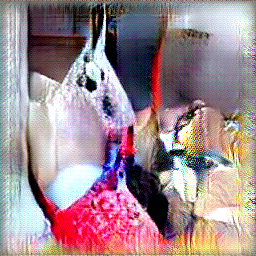

100%|███████████████████████████████████████████████████████████████████████████████▋| 255/256 [00:45<00:00,  5.56it/s]

Loss at step 256: -47.773



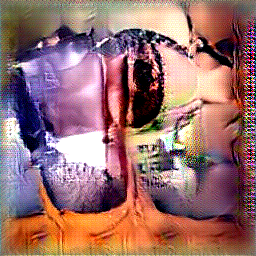
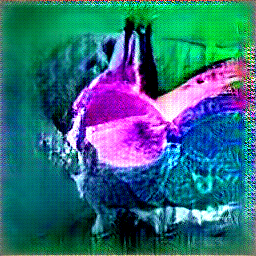
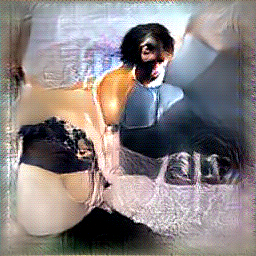
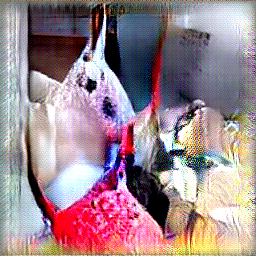

100%|████████████████████████████████████████████████████████████████████████████████| 256/256 [00:46<00:00,  5.55it/s]



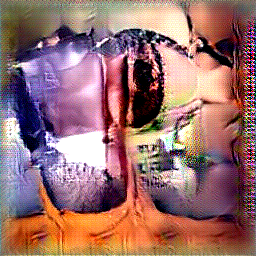
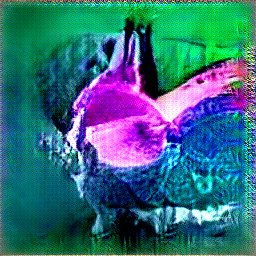
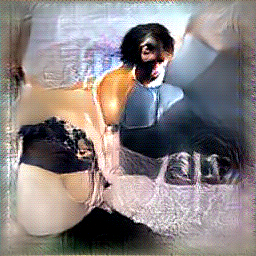
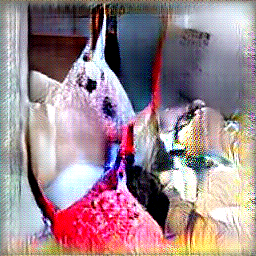

In [64]:
divL = 1e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2,)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) - divL * objectives.diversity('features_25')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=True, preprocess=False,show_image=False,
                           thresholds=(64, 128, 256, ), verbose=True)

  0%|                                                                                          | 0/192 [00:00<?, ?it/s]

Initial loss: 4.103


 33%|███████████████████████████                                                      | 64/192 [00:11<00:23,  5.36it/s]

Loss at step 64: -27.325


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:22<00:11,  5.60it/s]

Loss at step 128: -45.837


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:34<00:00,  5.61it/s]

Loss at step 192: -47.021



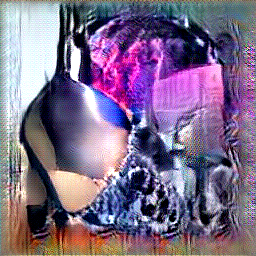
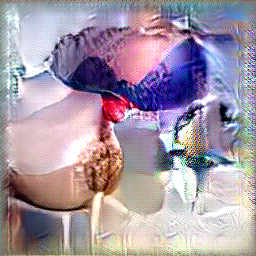
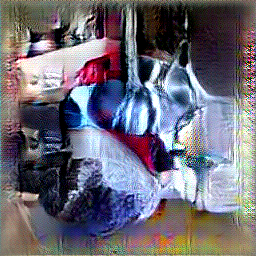
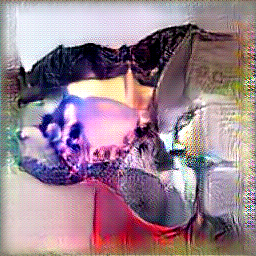

In [79]:
# Small divL and add weight decay to make norm not exploding.
divL = .2e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2,weight_decay=0.001)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) - divL * objectives.diversity('features_25')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=False, preprocess=False,show_image=True,
                           thresholds=(64, 128, 192, ), verbose=True)
render.show(images[-1])

  1%|▍                                                                                 | 1/192 [00:00<00:35,  5.44it/s]

Initial loss: 4.486


 34%|███████████████████████████▍                                                     | 65/192 [00:11<00:22,  5.64it/s]

Loss at step 64: -31.846


 67%|█████████████████████████████████████████████████████▊                          | 129/192 [00:22<00:11,  5.68it/s]

Loss at step 128: -58.445


100%|████████████████████████████████████████████████████████████████████████████████| 192/192 [00:33<00:00,  5.68it/s]

Loss at step 192: -58.309



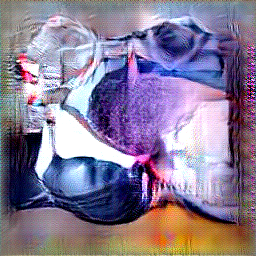
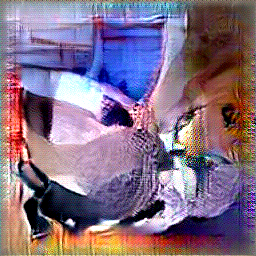
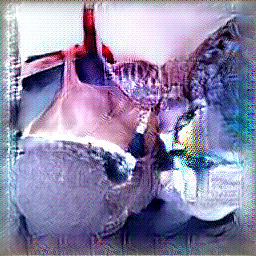
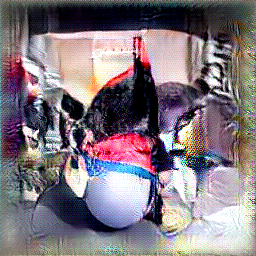

In [78]:
# Small divL and add weight decay to make norm not exploding.
divL = .2e1
# for iCh in Categ_list:
iCh = 459
RND = torch.randint(1000, (1,)).item()
tfms = [pad(12, mode="constant", constant_value=.5),
        jitter(8),
        random_scale([1 + (i - 5) / 50. for i in range(11)]),
        random_rotate(list(range(-10, 11)) + 5 * [0]),
        jitter(4),
        matVGG_preprocess]
GANparam_f = lambda: GANparam(batch=4, sd=1)
GANopt = lambda params: torch.optim.Adam(params, 5e-2,weight_decay=1E-4)  # 5E-2 looks good
obj = objectives.channel('classifier_6', n_channel=iCh, batch=None) - divL * objectives.diversity('features_25')  #  optimizing the
images = render.render_vis(matvgg, obj, GANparam_f, GANopt, transforms=tfms, show_inline=False, preprocess=False,show_image=True,
                           thresholds=(64, 128, 192, ), verbose=True)
render.show(images[-1])

In [67]:
GANparam_f()[0][0].norm(dim=1)

tensor([64.6698, 64.3421, 64.8439, 63.2520], device='cuda:0',
       grad_fn=<NormBackward3>)